### **Group 10: Credit Card Fraud Detection in the US**
This notebook addresses a **Credit Card Fraud Detection problem** using **classification machine learning models**. The goal is to identify fraudulent transactions in a dataset containing real-world credit card transactions in the **United States**.

---

### **⚠️ WARNING: Heavy Computation Required**
This notebook involves **intensive computations** due to the dataset size and hyperparameter tuning.
Running time may be upwards of 25 minutes depending on machine specifications

## Library Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score
from collections import Counter
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score,accuracy_score
import plotly.express as px


## Exploratory Data Analysis

In [2]:
df = pd.read_csv('fraudTrain.csv') # read the data
df.head()

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,...,36.0788,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0
1,1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,...,48.8878,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0
2,2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,...,42.1808,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0
3,3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,...,46.2306,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0
4,4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,...,38.4207,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0


In [3]:
df.info() # check the data types and missing values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1296675 entries, 0 to 1296674
Data columns (total 23 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   Unnamed: 0             1296675 non-null  int64  
 1   trans_date_trans_time  1296675 non-null  object 
 2   cc_num                 1296675 non-null  int64  
 3   merchant               1296675 non-null  object 
 4   category               1296675 non-null  object 
 5   amt                    1296675 non-null  float64
 6   first                  1296675 non-null  object 
 7   last                   1296675 non-null  object 
 8   gender                 1296675 non-null  object 
 9   street                 1296675 non-null  object 
 10  city                   1296675 non-null  object 
 11  state                  1296675 non-null  object 
 12  zip                    1296675 non-null  int64  
 13  lat                    1296675 non-null  float64
 14  long              

In [4]:
df.describe() # check the summary statistics

,Unnamed: 0,cc_num,amt,zip,lat,long,city_pop,unix_time,merch_lat,merch_long,is_fraud
count,1.296675e+06,1.296675e+06,1.296675e+06,1.296675e+06,1.296675e+06,1.296675e+06,1.296675e+06,1.296675e+06,1.296675e+06,1.296675e+06,1.296675e+06
mean,6.483370e+05,4.171920e+17,7.035104e+01,4.880067e+04,3.853762e+01,-9.022634e+01,8.882444e+04,1.349244e+09,3.853734e+01,-9.022646e+01,5.788652e-03
std,3.743180e+05,1.308806e+18,1.603160e+02,2.689322e+04,5.075808e+00,1.375908e+01,3.019564e+05,1.284128e+07,5.109788e+00,1.377109e+01,7.586269e-02
min,0.000000e+00,6.041621e+10,1.000000e+00,1.257000e+03,2.002710e+01,-1.656723e+02,2.300000e+01,1.325376e+09,1.902779e+01,-1.666712e+02,0.000000e+00
25%,3.241685e+05,1.800429e+14,9.650000e+00,2.623700e+04,3.462050e+01,-9.679800e+01,7.430000e+02,1.338751e+09,3.473357e+01,-9.689728e+01,0.000000e+00
50%,6.483370e+05,3.521417e+15,4.752000e+01,4.817400e+04,3.935430e+01,-8.747690e+01,2.456000e+03,1.349250e+09,3.936568e+01,-8.743839e+01,0.000000e+00
75%,9.725055e+05,4.642255e+15,8.314000e+01,7.204200e+04,4.194040e+01,-8.015800e+01,2.032800e+04,1.359385e+09,4.195716e+01,-8.023680e+01,0.000000e+00
max,1.296674e+06,4.992346e+18,2.894890e+04,9.978300e+04,6.669330e+01,-6.795030e+01,2.906700e+06,1.371817e+09,6.751027e+01,-6.695090e+01,1.000000e+00


In [5]:
df.isnull().sum() # check the missing values

Unnamed: 0               0
trans_date_trans_time    0
cc_num                   0
merchant                 0
category                 0
amt                      0
first                    0
last                     0
gender                   0
street                   0
city                     0
state                    0
zip                      0
lat                      0
long                     0
city_pop                 0
job                      0
dob                      0
trans_num                0
unix_time                0
merch_lat                0
merch_long               0
is_fraud                 0
dtype: int64

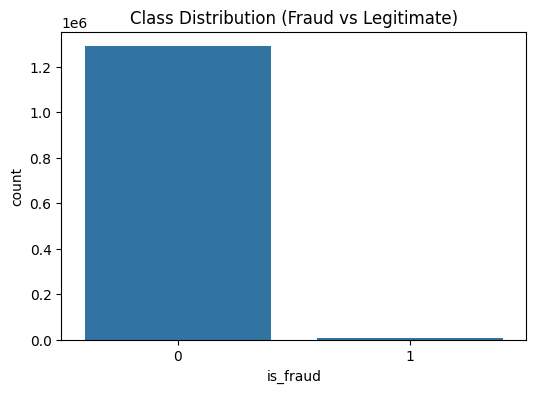

is_fraud
0    0.994211
1    0.005789
Name: proportion, dtype: float64


In [6]:
# Class distribution
plt.figure(figsize=(6,4)) 
sns.countplot(x="is_fraud", data=df)
plt.title("Class Distribution (Fraud vs Legitimate)")
plt.show()

print(df["is_fraud"].value_counts(normalize=True))  # Check fraud distribution to check if the data is imbalanced 


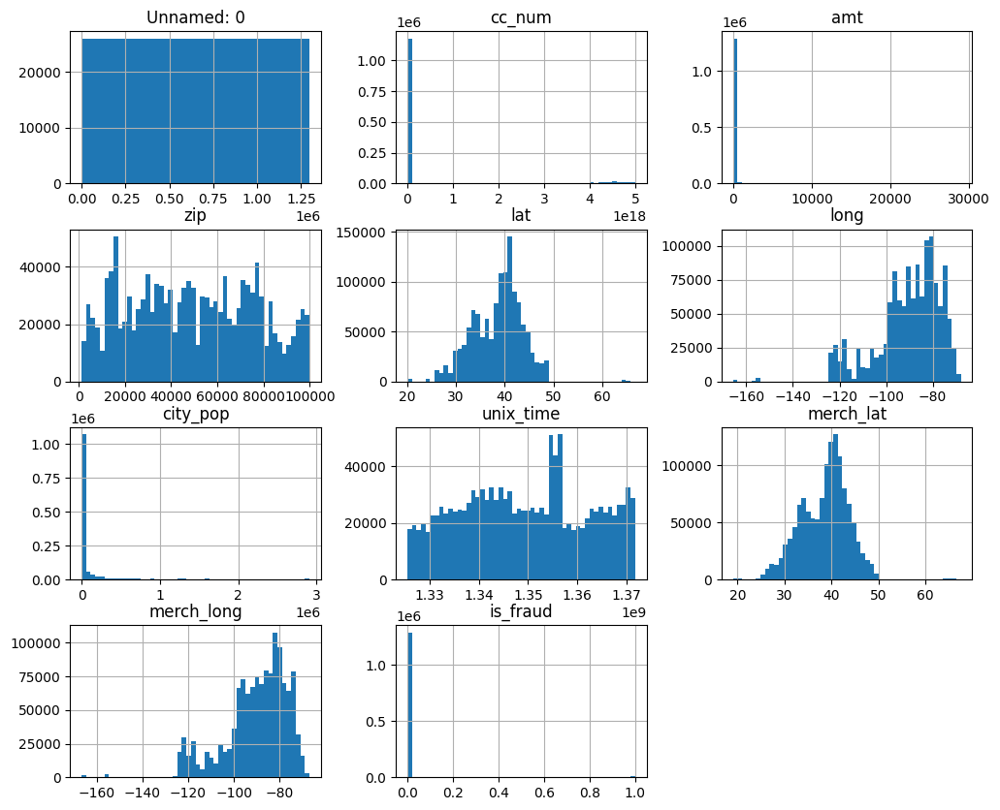

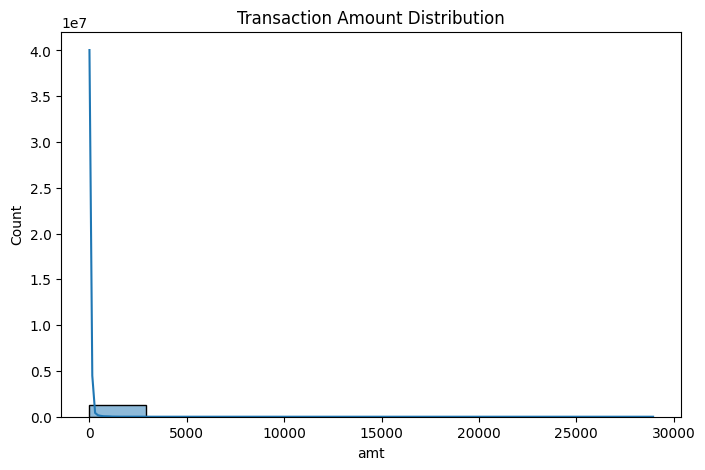

In [7]:
# Histograms for numerical features 
df.hist(figsize=(12, 10), bins=50)
plt.show()

# Distribution of transaction amounts
plt.figure(figsize=(8,5))
sns.histplot(df['amt'], bins=10, kde=True)
plt.title('Transaction Amount Distribution')
plt.show()


## Feature Engineering

In [8]:
# Convert transaction time to datetime
df["trans_date_trans_time"] = pd.to_datetime(df["trans_date_trans_time"])
df["hour"] = df["trans_date_trans_time"].dt.hour
df["day"] = df["trans_date_trans_time"].dt.day
df["month"] = df["trans_date_trans_time"].dt.month

# Plot fraud transactions by hour using Plotly
fig = px.histogram(df, x="hour", color="is_fraud", barmode="group",
                   title="Fraud Transactions by Hour",
                   labels={"hour": "Hour of Day", "count": "Transaction Count", "is_fraud": "Fraud Status"},
                   category_orders={"hour": list(range(24))})  # Ensures hours are in order

# Show the plot
fig.show()


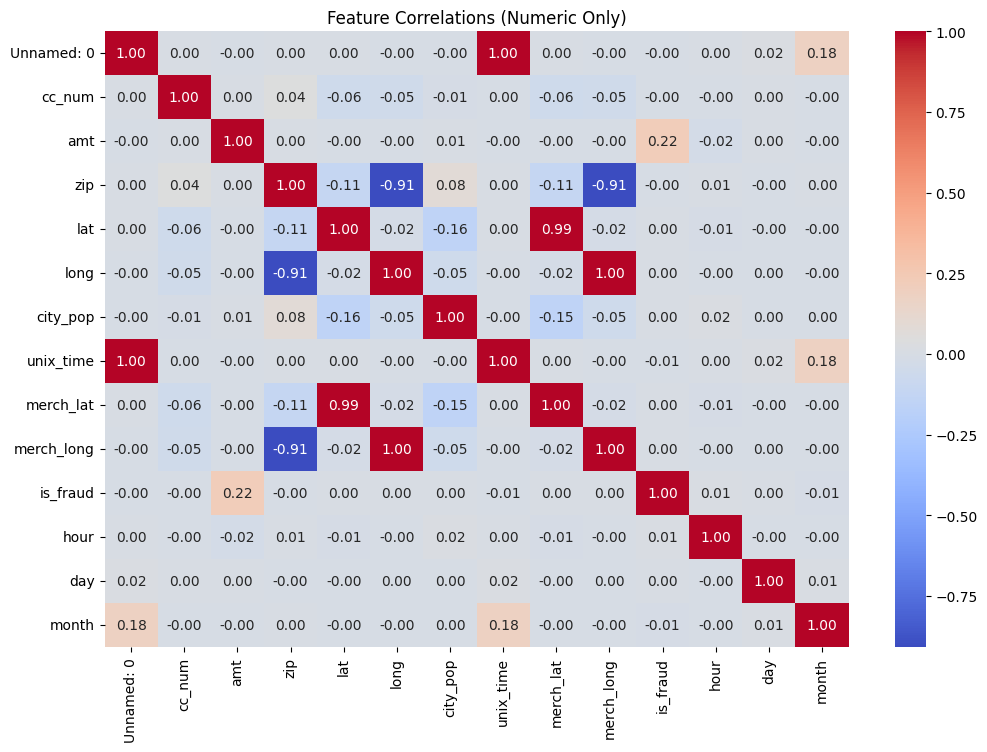

In [9]:
# Select only numeric columns for correlation matrix
numeric_df = df.select_dtypes(include=[np.number])  

# Plot heatmap
plt.figure(figsize=(12,8))
sns.heatmap(numeric_df.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Feature Correlations (Numeric Only)")
plt.show()


In [10]:
from geopy.distance import geodesic 

# Calculate the distance between the customer and the merchant based on their latitude and longitude
def calculate_distance(row):
    return geodesic((row["lat"], row["long"]), (row["merch_lat"], row["merch_long"])).km 

df["geo_distance"] = df.apply(calculate_distance, axis=1) # Apply the function to each row


In [11]:
# Extract day of the week (0 = Monday, 6 = Sunday)
df["day_of_week"] = df["trans_date_trans_time"].dt.dayofweek

# Create is_weekend column (1 for Saturday/Sunday, 0 otherwise)
df["is_weekend"] = (df["day_of_week"] >= 5).astype(int)  # Saturday=5, Sunday=6

# Plot fraud count on weekends vs weekdays
fig = px.histogram(df, x="is_weekend", color="is_fraud", barmode="group",
                   title="Fraud Transactions on Weekends vs Weekdays",
                   labels={"is_weekend": "Is Weekend (1=Yes, 0=No)", "count": "Transaction Count", "is_fraud": "Fraud Status"},
                   category_orders={"is_weekend": [0, 1]})  # Ensure proper order

# Show plot
fig.show()


In [12]:
df["dob"] = pd.to_datetime(df["dob"]) # Convert date of birth to datetime
df["age"] = (df["trans_date_trans_time"] - df["dob"]).dt.days // 365 # Calculate age of credit card holder in years

In [13]:
# drop the columns that are not needed
df.drop(columns=["trans_num","job","first","last", "trans_date_trans_time", "Unnamed: 0","unix_time","street","city","state","zip","merchant","cc_num","merch_lat","merch_long","lat","long","dob"],inplace=True)

In [14]:
df.head().T # check the data after dropping the columns

,0,1,2,3,4
category,misc_net,grocery_pos,entertainment,gas_transport,misc_pos
amt,4.97,107.23,220.11,45.0,41.96
gender,F,F,M,M,M
city_pop,3495,149,4154,1939,99
is_fraud,0,0,0,0,0
hour,0,0,0,0,0
day,1,1,1,1,1
month,1,1,1,1,1
geo_distance,78.773821,30.216618,108.102912,95.685115,77.702395
day_of_week,1,1,1,1,1


In [ ]:
from sklearn.preprocessing import LabelEncoder
# List of categorical columns to encode
categorical_columns = ["category", "gender"]

# Apply Label Encoding
label_encoders = {}  # Store encoders for potential decoding later

for col in categorical_columns:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])  # Encode the column
    label_encoders[col] = le  # Save the encoder

df.head()




,category,amt,gender,city_pop,is_fraud,hour,day,month,geo_distance,day_of_week,is_weekend,age
0,8,4.97,0,3495,0,0,1,1,78.773821,1,0,30
1,4,107.23,0,149,0,0,1,1,30.216618,1,0,40
2,0,220.11,1,4154,0,0,1,1,108.102912,1,0,56
3,2,45.00,1,1939,0,0,1,1,95.685115,1,0,52
4,9,41.96,1,99,0,0,1,1,77.702395,1,0,32


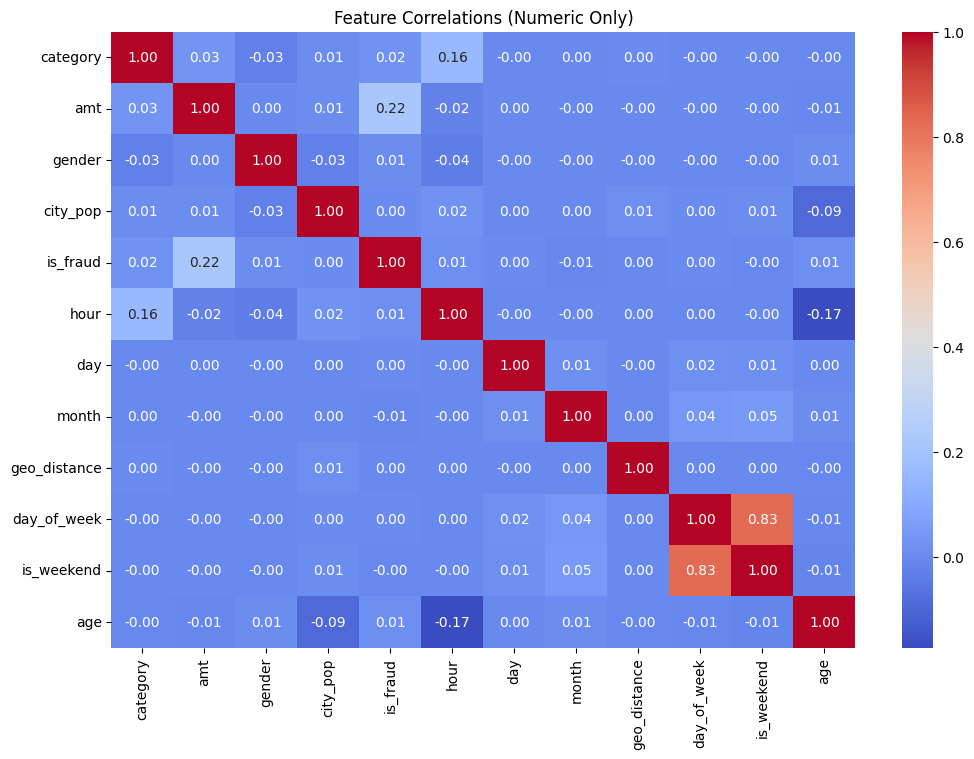

In [16]:
# Select only numeric columns for correlation matrix
numeric_df = df.select_dtypes(include=[np.number])  

# Plot heatmap
plt.figure(figsize=(12,8))
sns.heatmap(numeric_df.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Feature Correlations (Numeric Only)")
plt.show()


In [17]:
df.drop(columns=["is_weekend"], inplace=True) # drop the is_weekend column as it is highly correlated with day_of_week 


## XGBOOST Classification   

In [18]:
# Define Features and Target
X = df.drop(columns=["is_fraud"])  # Features
y = df["is_fraud"]  # Target

In [19]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
) # Split the data into training and testing sets

In [20]:
# Calculate class imbalance ratio
class_counts = Counter(y_train)
scale_pos_weight = class_counts[0] / class_counts[1]  # Ratio of non-fraud to fraud cases
print(f"Scale Pos Weight: {scale_pos_weight:.2f}")


Scale Pos Weight: 171.75


In [21]:
dtrain = xgb.DMatrix(X_train, label=y_train) # Create DMatrix for XGBoost training
dtest = xgb.DMatrix(X_test, label=y_test) # Create DMatrix for XGBoost testing

In [ ]:
# Define initial model
xgb_model = xgb.XGBClassifier(
    objective="binary:logistic",
    eval_metric="logloss",
    use_label_encoder=False,
    scale_pos_weight=scale_pos_weight,
    learning_rate=0.1,
    max_depth=6,
    n_estimators=200,
    random_state=42
)
 
# Train model
xgb_model.fit(X_train, y_train)


c:\Users\Wambui\AppData\Local\Programs\Python\Python313\Lib\site-packages\xgboost\core.py:158: UserWarning:

[19:56:24] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.




XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.1, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=6,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=None, num_parallel_tree=None, random_state=42, ...)

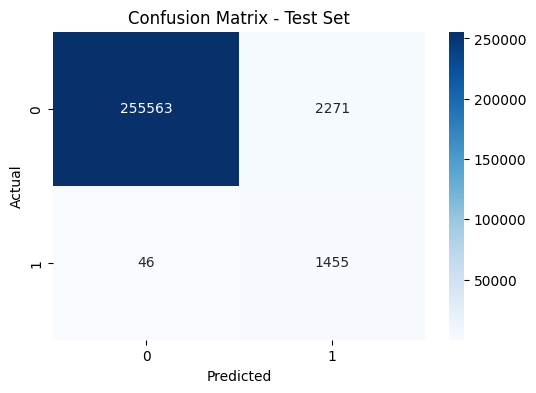

In [ ]:
# Predictions
y_train_pred = xgb_model.predict(X_train)
y_test_pred = xgb_model.predict(X_test)

# Confusion Matrix
plt.figure(figsize=(6,4))
sns.heatmap(confusion_matrix(y_test, y_test_pred), annot=True, fmt="d", cmap="Blues")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix - Test Set")
plt.show()

In [24]:
train_accuracy_xgb = accuracy_score(y_train, y_train_pred)
test_accuracy_xgb = accuracy_score(y_test, y_test_pred)
test_recall_xgb = recall_score(y_test, y_test_pred)
test_precision_xgb = precision_score(y_test, y_test_pred, zero_division=1)
test_f1_xgb = f1_score(y_test, y_test_pred)

# Print Metrics
print(f"Train Accuracy: {train_accuracy_xgb:.4f}")
print(f"Test Accuracy: {test_accuracy_xgb:.4f}")
print(f"Test Recall: {test_recall_xgb:.4f}")
print(f"Test Precision: {test_precision_xgb:.4f}")
print(f"Test F1 Score: {test_f1_xgb:.4f}")


Train Accuracy: 0.9917
Test Accuracy: 0.9911
Test Recall: 0.9694
Test Precision: 0.3905
Test F1 Score: 0.5567


<Figure size 1000x600 with 0 Axes>

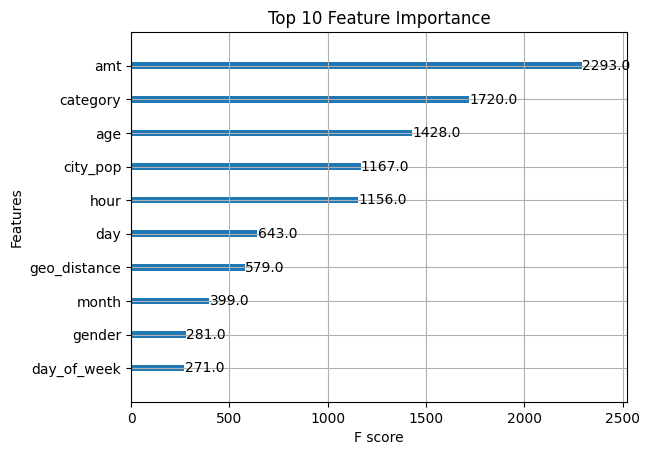

In [25]:
# Plot Feature Importance
plt.figure(figsize=(10,6))
xgb.plot_importance(xgb_model, max_num_features=10, importance_type="weight", title="Top 10 Feature Importance")
plt.show()


In [26]:
from sklearn.model_selection import RandomizedSearchCV

# Define the base model
xgb_model = xgb.XGBClassifier(
    objective="binary:logistic",
    eval_metric="logloss",
    use_label_encoder=False,
    scale_pos_weight=scale_pos_weight,
    random_state=42
)

# Define a more extensive hyperparameter search space
param_dist = {
    "max_depth": np.arange(4, 10),  # Test deeper trees but not too extreme
    "learning_rate": np.linspace(0.03, 0.3, 10),  # Cover wider learning rates
    "n_estimators": np.arange(100, 400, 50),  # More extensive testing of tree numbers
    "subsample": np.linspace(0.6, 1.0, 6),  # Allow better generalization
    "colsample_bytree": np.linspace(0.6, 1.0, 6),  # Ensure enough features per tree
    "gamma": np.linspace(0, 5, 6),  # Control tree pruning
    "reg_alpha": np.linspace(0, 1, 6),  # L1 regularization (feature selection)
    "reg_lambda": np.linspace(0, 5, 6),  # L2 regularization (complexity control)
}

# Set up RandomizedSearchCV with more iterations but within a 40-minute limit
random_search = RandomizedSearchCV(
    estimator=xgb_model,
    param_distributions=param_dist,
    n_iter=40,  # More iterations for better tuning but still time-efficient
    scoring="recall",  # Prioritizing fraud detection
    cv=5,  # More cross-validation folds for stability
    verbose=2,
    n_jobs=-1,  # Parallel computation to speed up training
    random_state=42
)

# Run Randomized Search
random_search.fit(X_train, y_train)

# Retrieve best parameters and best model
best_xgb_params = random_search.best_params_
best_xgb_model = random_search.best_estimator_

# Print best parameters
print("✅ Best Found Parameters:", best_xgb_params)

# Evaluate best model
y_test_pred = best_xgb_model.predict(X_test)

from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score

print(f"Test Accuracy: {accuracy_score(y_test, y_test_pred):.4f}")
print(f"Test Recall: {recall_score(y_test, y_test_pred):.4f}")
print(f"Test Precision: {precision_score(y_test, y_test_pred, zero_division=1):.4f}")
print(f"Test F1 Score: {f1_score(y_test, y_test_pred):.4f}")


Fitting 5 folds for each of 40 candidates, totalling 200 fits


c:\Users\Wambui\AppData\Local\Programs\Python\Python313\Lib\site-packages\xgboost\core.py:158: UserWarning:

[20:11:42] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.




✅ Best Found Parameters: {'subsample': np.float64(1.0), 'reg_lambda': np.float64(5.0), 'reg_alpha': np.float64(0.0), 'n_estimators': np.int64(200), 'max_depth': np.int64(5), 'learning_rate': np.float64(0.09), 'gamma': np.float64(5.0), 'colsample_bytree': np.float64(0.9199999999999999)}
Test Accuracy: 0.9861
Test Recall: 0.9740
Test Precision: 0.2904
Test F1 Score: 0.4474


In [30]:
pip install bayesian-optimization

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [31]:
from bayes_opt import BayesianOptimization
# Bayesian Optimization for XGBoost
def xgb_evaluate(max_depth, learning_rate, n_estimators, subsample, colsample_bytree):
    params = {
        "max_depth": int(max_depth),
        "learning_rate": learning_rate,
        "n_estimators": int(n_estimators),
        "subsample": subsample,
        "colsample_bytree": colsample_bytree,
        "eval_metric": "logloss",
        "random_state": 42
    }
    
    model = xgb.XGBClassifier(**params)
    model.fit(X_train, y_train)
    
    y_pred = model.predict(X_test)
    
    recall = recall_score(y_test, y_pred)  # **Maximize recall only**
    return recall


In [32]:
xgb_optimizer = BayesianOptimization(
    f=xgb_evaluate,
    pbounds={
        "max_depth": (3, 7),  # Reduce overfitting risk
        "learning_rate": (0.01, 0.1),  # Increase learning speed
        "n_estimators": (150, 400),
        "subsample": (0.7, 1.0),  
        "colsample_bytree": (0.7, 1.0),
    },
    random_state=42,
)

# Run Bayesian Optimization
xgb_optimizer.maximize(init_points=5, n_iter=20)

# Retrieve best parameters
best_xgb_params = xgb_optimizer.max["params"]


|   iter    |  target   | colsam... | learni... | max_depth | n_esti... | subsample |
-------------------------------------------------------------------------------------
| 1         | 0.8148    | 0.8124    | 0.09556   | 5.928     | 299.7     | 0.7468    |
| 2         | 0.7568    | 0.7468    | 0.01523   | 6.465     | 300.3     | 0.9124    |
| 3         | 0.8248    | 0.7062    | 0.09729   | 6.33      | 203.1     | 0.7545    |
| 4         | 0.7702    | 0.755     | 0.03738   | 5.099     | 258.0     | 0.7874    |
| 5         | 0.6755    | 0.8836    | 0.02255   | 4.169     | 241.6     | 0.8368    |
| 6         | 0.7875    | 0.8161    | 0.0722    | 4.032     | 358.0     | 0.8829    |
| 7         | 0.6076    | 0.9719    | 0.01948   | 3.589     | 381.3     | 0.9312    |
| 8         | 0.7615    | 0.9663    | 0.0279    | 5.203     | 298.6     | 0.8395    |
| 9         | 0.7828    | 0.9621    | 0.03207   | 6.635     | 204.2     | 0.9343    |
| 10        | 0.6169    | 1.0       | 0.01      | 5.06

In [33]:
best_xgb_params = {k: int(v) if isinstance(v, float) else v for k, v in best_xgb_params.items()} # Convert float to int
# Train the final model with the best parameters
xgb_model = xgb.XGBClassifier(**best_xgb_params,scale_pos_weight=scale_pos_weight, eval_metric="logloss", use_label_encoder=False, random_state=42)
xgb_model.fit(X_train, y_train)

c:\Users\Wambui\AppData\Local\Programs\Python\Python313\Lib\site-packages\xgboost\core.py:158: UserWarning:

[20:19:11] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.




XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
              device=None, early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=6, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=233, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [34]:
y_train_pred = xgb_model.predict(X_train)
y_test_pred = xgb_model.predict(X_test)

# Compute accuracy
train_accuracy = accuracy_score(y_train, y_train_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)

# Print results
print(f" Training Accuracy: {train_accuracy}")
print(f" Testing Accuracy: {test_accuracy}")


 Training Accuracy: 0.9942111554552991
 Testing Accuracy: 0.9942121194593865


c:\Users\Wambui\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.



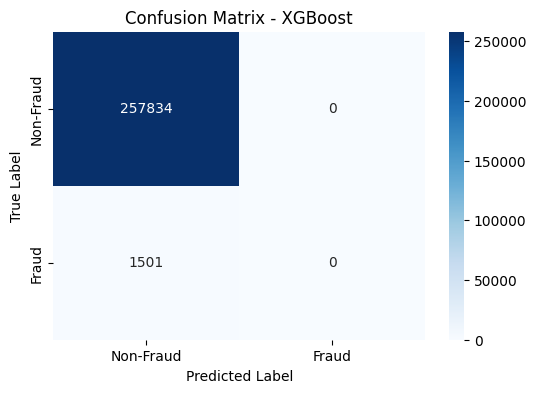

XGBoost Model Evaluation:
Accuracy: 0.9942
Precision: 0.0000
Recall: 0.0000
F1 Score: 0.0000


In [35]:
y_test_pred_xgb = xgb_model.predict(X_test)

# Compute Evaluation Metrics
xgb_accuracy = accuracy_score(y_test, y_test_pred_xgb)
xgb_precision = precision_score(y_test, y_test_pred_xgb)
xgb_recall = recall_score(y_test, y_test_pred_xgb)
xgb_f1 = f1_score(y_test, y_test_pred_xgb)

# Display Confusion Matrix
cm_xgb = confusion_matrix(y_test, y_test_pred_xgb)

plt.figure(figsize=(6,4))
sns.heatmap(cm_xgb, annot=True, fmt="d", cmap="Blues", xticklabels=["Non-Fraud", "Fraud"], yticklabels=["Non-Fraud", "Fraud"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix - XGBoost")
plt.show()

# Print Evaluation Metrics
print(f"XGBoost Model Evaluation:")
print(f"Accuracy: {xgb_accuracy:.4f}")
print(f"Precision: {xgb_precision:.4f}")
print(f"Recall: {xgb_recall:.4f}")
print(f"F1 Score: {xgb_f1:.4f}")

Train Accuracy: 0.0058
Test Accuracy: 0.0058
Adjusted Recall: 1.0000
Adjusted Precision: 0.0058


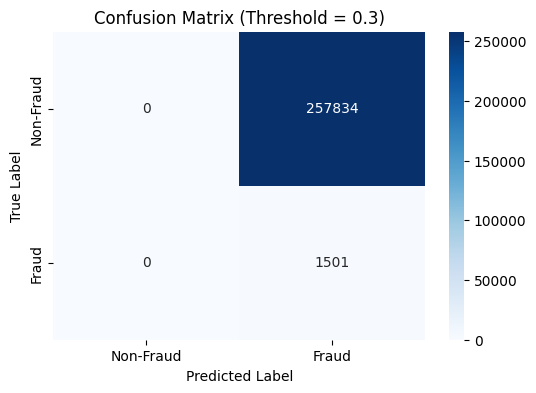

In [36]:
# Get fraud probabilities
y_train_prob = xgb_model.predict_proba(X_train)[:, 1]  # Train set probabilities
y_test_prob = xgb_model.predict_proba(X_test)[:, 1]    # Test set probabilities

# Set a lower decision threshold to improve recall
threshold = 0.3
y_train_pred_adjusted = (y_train_prob > threshold).astype(int)
y_test_pred_adjusted = (y_test_prob > threshold).astype(int)

# Calculate metrics
train_accuracy = accuracy_score(y_train, y_train_pred_adjusted)
test_accuracy = accuracy_score(y_test, y_test_pred_adjusted)

adjusted_recall = recall_score(y_test, y_test_pred_adjusted)
adjusted_precision = precision_score(y_test, y_test_pred_adjusted, zero_division=1)

# Print Accuracy and Scores
print(f"Train Accuracy: {train_accuracy:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Adjusted Recall: {adjusted_recall:.4f}")
print(f"Adjusted Precision: {adjusted_precision:.4f}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_test_pred_adjusted)

plt.figure(figsize=(6,4))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Non-Fraud", "Fraud"], yticklabels=["Non-Fraud", "Fraud"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix (Threshold = 0.3)")
plt.show()


## Decision Tree Classification

In [37]:
df2 = pd.read_csv('fraudTrain.csv') # read the data again to get the original data for the category column
df2.head()

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,...,36.0788,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0
1,1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,...,48.8878,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0
2,2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,...,42.1808,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0
3,3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,...,46.2306,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0
4,4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,...,38.4207,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0


In [38]:
df["Category"] = df2["category"] # add the category column to the dataframe
df["Gender"] = df2["gender"] #add the gender column to the dataframe
df.drop(columns=["category","gender"],inplace=True) # drop the label encoded columns

In [39]:
from sklearn.preprocessing import OneHotEncoder

# Define categorical columns (Replace with actual categorical columns in your dataset)
categorical_columns = ["Category", "Gender"]

# Apply One-Hot Encoding
encoder = OneHotEncoder(sparse_output=False, drop="first")  # Drop first column to avoid multicollinearity
encoded_columns = encoder.fit_transform(df[categorical_columns])

# Convert encoded values into a DataFrame
encoded_df = pd.DataFrame(encoded_columns, columns=encoder.get_feature_names_out(categorical_columns))

# Drop original categorical columns & concatenate new one-hot encoded columns
df = df.drop(columns=categorical_columns).reset_index(drop=True)
df = pd.concat([df, encoded_df], axis=1)

In [40]:
df.head().T # check the data after one hot encoding the categorical columns

,0,1,2,3,4
amt,4.970000,107.230000,220.110000,45.000000,41.960000
city_pop,3495.000000,149.000000,4154.000000,1939.000000,99.000000
is_fraud,0.000000,0.000000,0.000000,0.000000,0.000000
hour,0.000000,0.000000,0.000000,0.000000,0.000000
day,1.000000,1.000000,1.000000,1.000000,1.000000
month,1.000000,1.000000,1.000000,1.000000,1.000000
geo_distance,78.773821,30.216618,108.102912,95.685115,77.702395
day_of_week,1.000000,1.000000,1.000000,1.000000,1.000000
age,30.000000,40.000000,56.000000,52.000000,32.000000
Category_food_dining,0.000000,0.000000,0.000000,0.000000,0.000000


In [41]:
# Define Features (X) and Target (y)
X = df.drop(columns=["is_fraud"])  # Features
y = df["is_fraud"]  # Target

# Split dataset into training (80%) and testing (20%)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y  # Preserve class balance
)

print("Training Set Size:", X_train.shape)
print("Testing Set Size:", X_test.shape)


Training Set Size: (1037340, 22)
Testing Set Size: (259335, 22)


In [42]:
from sklearn.tree import DecisionTreeClassifier

# Initialize Decision Tree model
dt_model = DecisionTreeClassifier(
    criterion="entropy",  # Change to "gini" for default behavior
    max_depth=6,  # Prevents overfitting
    random_state=42,
    class_weight="balanced"  # Balance class weights
)

# Train Decision Tree
dt_model.fit(X_train, y_train)


DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=6, random_state=42)

In [43]:
from sklearn.metrics import accuracy_score

# Make predictions
y_train_pred = dt_model.predict(X_train)
y_test_pred = dt_model.predict(X_test)

# Compute accuracy
train_accuracy = accuracy_score(y_train, y_train_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)

# Print results
print(f" Training Accuracy: {train_accuracy}")
print(f" Testing Accuracy: {test_accuracy}")


 Training Accuracy: 0.9686274509803922
 Testing Accuracy: 0.9689397883047024


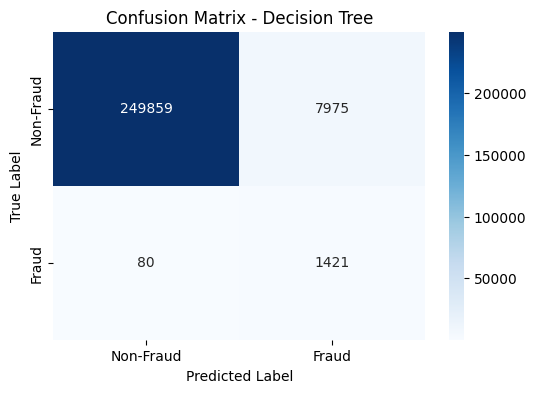

Precision: 0.1512
Recall: 0.9467
F1 Score: 0.2608


In [44]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score

cm = confusion_matrix(y_test, y_test_pred)

# Plot Confusion Matrix
plt.figure(figsize=(6,4))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Non-Fraud", "Fraud"], yticklabels=["Non-Fraud", "Fraud"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix - Decision Tree")
plt.show()

# 🚀 Step 2: Compute Precision, Recall, and F1 Score
precision = precision_score(y_test, y_test_pred)
recall = recall_score(y_test, y_test_pred)
f1 = f1_score(y_test, y_test_pred)

# Print Evaluation Metrics
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

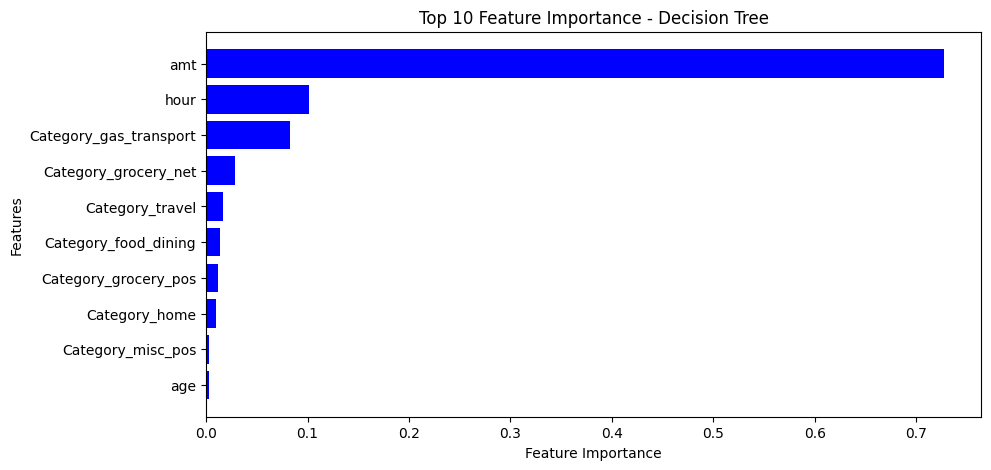

In [45]:
dt_feature_importance = dt_model.feature_importances_
dt_features = X_train.columns

# Sort feature importance in descending order
sorted_idx = np.argsort(dt_feature_importance)[::-1]

# Plot Feature Importance
plt.figure(figsize=(10, 5))
plt.barh(np.array(dt_features)[sorted_idx][:10], dt_feature_importance[sorted_idx][:10], color="blue")
plt.xlabel("Feature Importance")
plt.ylabel("Features")
plt.title("Top 10 Feature Importance - Decision Tree")
plt.gca().invert_yaxis()  # Highest importance on top
plt.show()

In [46]:
from bayes_opt import BayesianOptimization
# Bayesian Optimization for Decision Tree
def dt_evaluate(max_depth, min_samples_split, min_samples_leaf):
    params = {
        "max_depth": int(max_depth),
        "min_samples_split": int(min_samples_split),
        "min_samples_leaf": int(min_samples_leaf),
        "criterion": "entropy",
        "class_weight": "balanced",
        "random_state": 42
    }
    
    model = DecisionTreeClassifier(**params)
    model.fit(X_train, y_train)
    
    y_pred = model.predict(X_test)
    return recall_score(y_test, y_pred)  # Maximizing Recall

dt_optimizer = BayesianOptimization(
    f=dt_evaluate,
    pbounds={"max_depth": (3, 10), "min_samples_split": (2, 10), "min_samples_leaf": (1, 5)},
    random_state=42,
)
dt_optimizer.maximize(init_points=5, n_iter=20)
best_dt_params = dt_optimizer.max["params"]

|   iter    |  target   | max_depth | min_sa... | min_sa... |
-------------------------------------------------------------
| 1         | 0.9034    | 5.622     | 4.803     | 7.856     |
| 2         | 0.9567    | 7.191     | 1.624     | 3.248     |
| 3         | 0.8334    | 3.407     | 4.465     | 6.809     |
| 4         | 0.9567    | 7.957     | 1.082     | 9.759     |
| 5         | 0.9734    | 8.827     | 1.849     | 3.455     |
| 6         | 0.966     | 10.0      | 3.224     | 6.824     |
| 7         | 0.9634    | 10.0      | 5.0       | 2.0       |
| 8         | 0.9634    | 10.0      | 5.0       | 10.0      |
| 9         | 0.9654    | 10.0      | 1.0       | 2.0       |
| 10        | 0.968     | 9.129     | 1.008     | 5.828     |
| 11        | 0.966     | 10.0      | 1.0       | 10.0      |
| 12        | 0.9634    | 10.0      | 5.0       | 4.892     |
| 13        | 0.9567    | 7.394     | 5.0       | 2.0       |
| 14        | 0.9654    | 10.0      | 2.543     | 4.185     |
| 15    

In [47]:
# Convert float to int
best_dt_params = {k: int(v) for k, v in best_dt_params.items()}
# Train the final model with the best parameters
dt_model = DecisionTreeClassifier(**best_dt_params, criterion="entropy", class_weight="balanced", random_state=42)
dt_model.fit(X_train, y_train)

DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=8, min_samples_split=3, random_state=42)

In [48]:
y_train_pred = dt_model.predict(X_train)
y_test_pred = dt_model.predict(X_test)

# Compute accuracy
DT_train_accuracy = accuracy_score(y_train, y_train_pred)
DT_test_accuracy = accuracy_score(y_test, y_test_pred)

# Print results
print(f" Training Accuracy: {DT_train_accuracy}")
print(f" Testing Accuracy: {DT_test_accuracy}")


 Training Accuracy: 0.9697360556808761
 Testing Accuracy: 0.9694911986426823


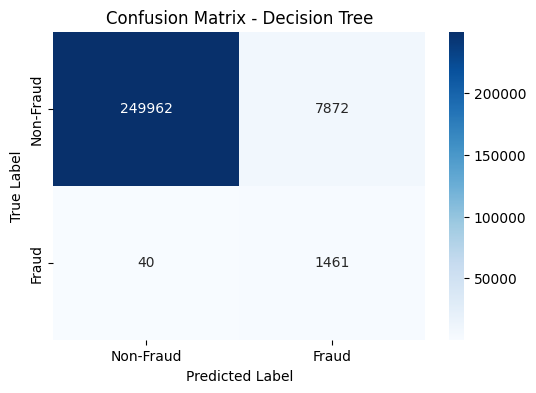

Precision: 0.1512
Recall: 0.9467
F1 Score: 0.2608


In [49]:
cm = confusion_matrix(y_test, y_test_pred)

# Plot Confusion Matrix
plt.figure(figsize=(6,4))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Non-Fraud", "Fraud"], yticklabels=["Non-Fraud", "Fraud"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix - Decision Tree")
plt.show()

# 🚀 Step 2: Compute Precision, Recall, and F1 Score
DT_precision = precision_score(y_test, y_test_pred)
DT_recall = recall_score(y_test, y_test_pred)
DT_f1 = f1_score(y_test, y_test_pred)

# Print Evaluation Metrics
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

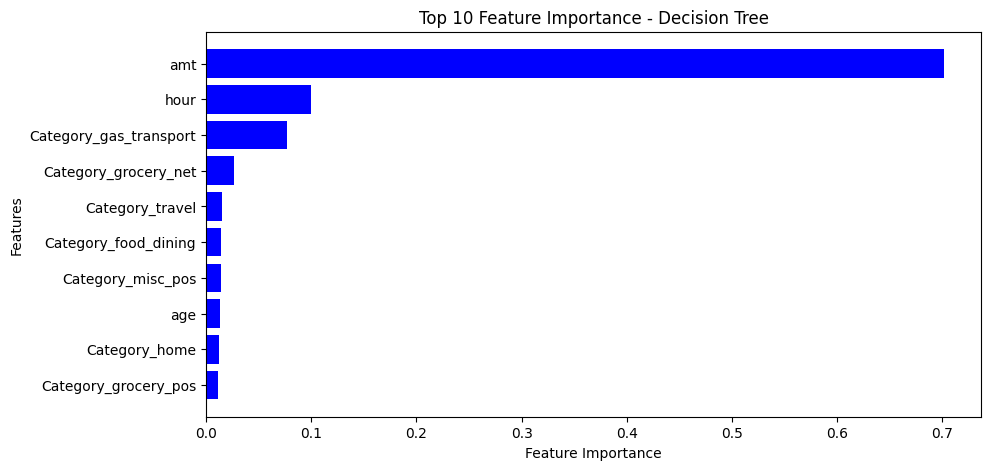

In [50]:
dt_feature_importance = dt_model.feature_importances_
dt_features = X_train.columns

# Sort feature importance in descending order
sorted_idx = np.argsort(dt_feature_importance)[::-1]

# Plot Feature Importance
plt.figure(figsize=(10, 5))
plt.barh(np.array(dt_features)[sorted_idx][:10], dt_feature_importance[sorted_idx][:10], color="blue")
plt.xlabel("Feature Importance")
plt.ylabel("Features")
plt.title("Top 10 Feature Importance - Decision Tree")
plt.gca().invert_yaxis()  # Highest importance on top
plt.show()

## Random Forest Classification

In [51]:
# Run Random Forest
from sklearn.ensemble import RandomForestClassifier
rf_model = RandomForestClassifier(
    n_estimators=100,  # Number of trees in the forest
    criterion="entropy",  # Use "entropy" for better splits
    max_depth=6,  # Prevent overfitting
    min_samples_split=5,  # Reduce splitting threshold
    min_samples_leaf=2,  # Ensure meaningful splits
    class_weight="balanced",  # Penalizes False Negatives (fraud cases)
    random_state=42,
    n_jobs=-1  # Use all CPU cores for faster training
)

rf_model.fit(X_train, y_train)  # Train the model


RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=6, min_samples_leaf=2, min_samples_split=5,
                       n_jobs=-1, random_state=42)

In [52]:
# Make predictions and compute accuracy
rf_train_accuracy = accuracy_score(y_train, rf_model.predict(X_train))
rf_test_accuracy = accuracy_score(y_test, rf_model.predict(X_test))

print(f"Random Forest Train Accuracy: {rf_train_accuracy:.4f}")
print(f"Random Forest Test Accuracy: {rf_test_accuracy:.4f}")

Random Forest Train Accuracy: 0.9701
Random Forest Test Accuracy: 0.9701


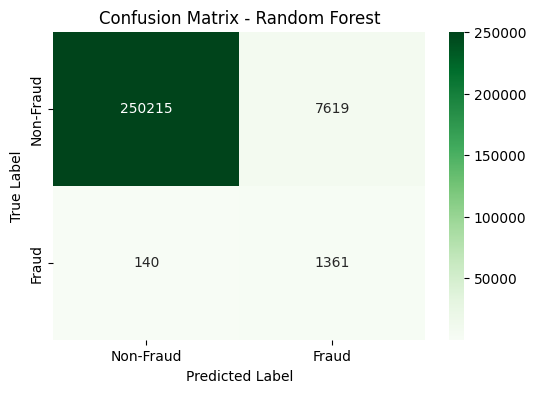

In [53]:
cm_rf = confusion_matrix(y_test, rf_model.predict(X_test))
# Plot Confusion Matrix
plt.figure(figsize=(6,4))
sns.heatmap(cm_rf, annot=True, fmt="d", cmap="Greens", xticklabels=["Non-Fraud", "Fraud"], yticklabels=["Non-Fraud", "Fraud"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix - Random Forest")
plt.show()


In [54]:
# Compute Evaluation Metrics
rf_precision = precision_score(y_test, rf_model.predict(X_test))
rf_recall = recall_score(y_test, rf_model.predict(X_test))
rf_f1 = f1_score(y_test, rf_model.predict(X_test))

# Print Evaluation Metrics
print(f"Random Forest Precision: {rf_precision:.4f}")
print(f"Random Forest Recall: {rf_recall:.4f}")
print(f"Random Forest F1 Score: {rf_f1:.4f}")

Random Forest Precision: 0.1516
Random Forest Recall: 0.9067
Random Forest F1 Score: 0.2597


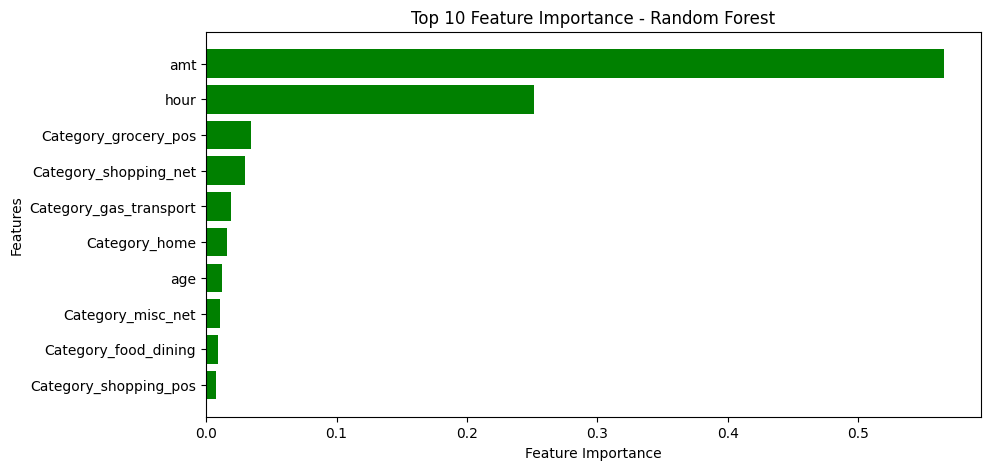

In [55]:
rf_feature_importance = rf_model.feature_importances_
rf_features = X_train.columns

# Sort feature importance in descending order
sorted_idx = np.argsort(rf_feature_importance)[::-1]

# Plot Feature Importance
plt.figure(figsize=(10, 5))
plt.barh(np.array(rf_features)[sorted_idx][:10], rf_feature_importance[sorted_idx][:10], color="green")
plt.xlabel("Feature Importance")
plt.ylabel("Features")
plt.title("Top 10 Feature Importance - Random Forest")
plt.gca().invert_yaxis()  # Highest importance on top
plt.show()

In [56]:
# Bayesian Optimization for Random Forest
def rf_evaluate(n_estimators, max_depth, min_samples_split, min_samples_leaf):
    params = {
        "n_estimators": int(n_estimators),
        "max_depth": int(max_depth),
        "min_samples_split": int(min_samples_split),
        "min_samples_leaf": int(min_samples_leaf),
        "criterion": "entropy",
        "class_weight": "balanced",
        "random_state": 42,
        "n_jobs": -1
    }
    
    model = RandomForestClassifier(**params)
    model.fit(X_train, y_train)
    
    y_pred = model.predict(X_test)
    return recall_score(y_test, y_pred)

rf_optimizer = BayesianOptimization(
    f=rf_evaluate,
    pbounds={"n_estimators": (50, 200), "max_depth": (3, 10), "min_samples_split": (2, 10), "min_samples_leaf": (1, 5)},
    random_state=42,
)
rf_optimizer.maximize(init_points=5, n_iter=20)
best_rf_params = rf_optimizer.max["params"]

|   iter    |  target   | max_depth | min_sa... | min_sa... | n_esti... |
-------------------------------------------------------------------------
| 1         | 0.8368    | 5.622     | 4.803     | 7.856     | 139.8     |
| 2         | 0.7955    | 4.092     | 1.624     | 2.465     | 179.9     |
| 3         | 0.9227    | 7.208     | 3.832     | 2.165     | 195.5     |
| 4         | 0.9147    | 8.827     | 1.849     | 3.455     | 77.51     |
| 5         | 0.8488    | 5.13      | 3.099     | 5.456     | 93.68     |
| 6         | 0.9154    | 8.235     | 2.207     | 3.704     | 78.1      |
| 7         | 0.94      | 10.0      | 5.0       | 9.578     | 200.0     |
| 8         | 0.8541    | 3.0       | 5.0       | 10.0      | 64.66     |
| 9         | 0.7722    | 3.112     | 1.426     | 7.057     | 199.7     |
| 10        | 0.94      | 10.0      | 5.0       | 6.257     | 197.3     |
| 11        | 0.9407    | 10.0      | 5.0       | 10.0      | 193.6     |
| 12        | 0.9407    | 10.0      | 

In [57]:
# Convert float to int
best_rf_params = {k: int(v) for k, v in best_rf_params.items()}
# Train the final model with the best parameters
rf_model = RandomForestClassifier(**best_rf_params, criterion="entropy", class_weight="balanced", random_state=42, n_jobs=-1)
rf_model.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=10, min_samples_split=7, n_estimators=190,
                       n_jobs=-1, random_state=42)

In [58]:
# Make predictions and compute accuracy
rf_train_accuracy = accuracy_score(y_train, rf_model.predict(X_train))
rf_test_accuracy = accuracy_score(y_test, rf_model.predict(X_test))

print(f"Random Forest Train Accuracy: {rf_train_accuracy:.4f}")
print(f"Random Forest Test Accuracy: {rf_test_accuracy:.4f}")

Random Forest Train Accuracy: 0.9853
Random Forest Test Accuracy: 0.9852


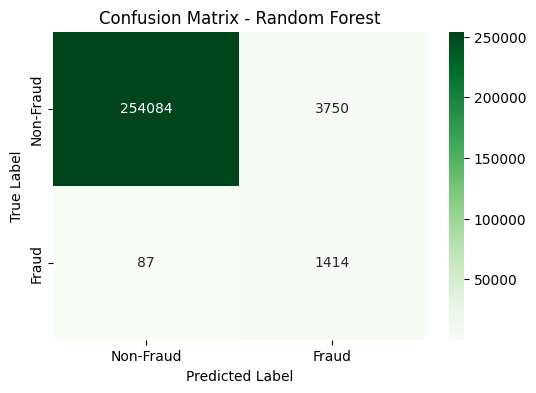

In [59]:
#plot the confusion matrix
cm_rf = confusion_matrix(y_test, rf_model.predict(X_test))

plt.figure(figsize=(6,4))
sns.heatmap(cm_rf, annot=True, fmt="d", cmap="Greens", xticklabels=["Non-Fraud", "Fraud"], yticklabels=["Non-Fraud", "Fraud"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix - Random Forest")
plt.show()


In [60]:
# Compute Evaluation Metrics
rf_precision = precision_score(y_test, rf_model.predict(X_test))
rf_recall = recall_score(y_test, rf_model.predict(X_test))
rf_f1 = f1_score(y_test, rf_model.predict(X_test))

# Print Evaluation Metrics
print(f"Random Forest Precision: {rf_precision:.4f}")
print(f"Random Forest Recall: {rf_recall:.4f}")
print(f"Random Forest F1 Score: {rf_f1:.4f}")

Random Forest Precision: 0.2738
Random Forest Recall: 0.9420
Random Forest F1 Score: 0.4243


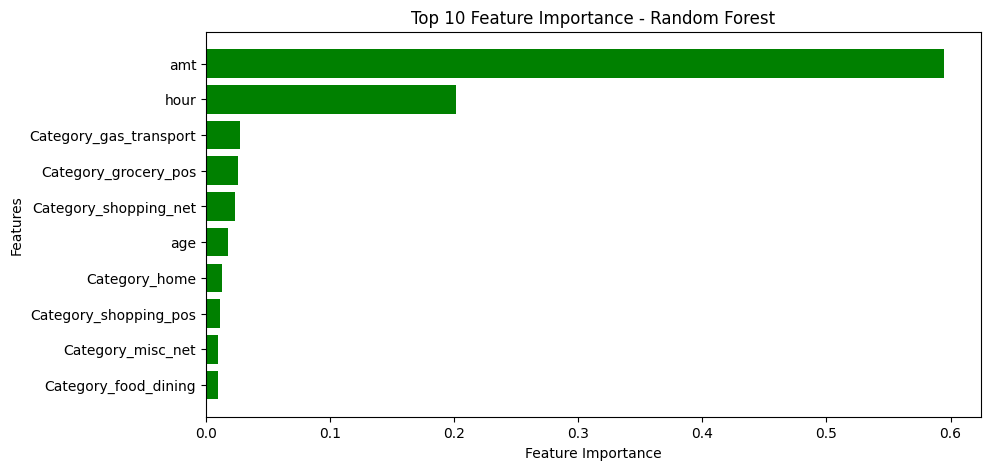

In [61]:
rf_feature_importance = rf_model.feature_importances_
rf_features = X_train.columns

# Sort feature importance in descending order
sorted_idx = np.argsort(rf_feature_importance)[::-1]

# Plot Feature Importance
plt.figure(figsize=(10, 5))
plt.barh(np.array(rf_features)[sorted_idx][:10], rf_feature_importance[sorted_idx][:10], color="green")
plt.xlabel("Feature Importance")
plt.ylabel("Features")
plt.title("Top 10 Feature Importance - Random Forest")
plt.gca().invert_yaxis()  # Highest importance on top
plt.show()

## Comparison of Models 

In [62]:
#Store Extracted Metrics for Each Model
model_metrics = {
    "XGBoost (Before Tuning)": {
        "train_accuracy": train_accuracy_xgb,
        "test_accuracy": test_accuracy_xgb,
        "precision": test_precision_xgb,
        "recall": test_recall_xgb,
        "f1_score": test_f1_xgb
    },
    "Tuned Decision Tree": {
        "train_accuracy": DT_train_accuracy,
        "test_accuracy": DT_test_accuracy,
        "precision": DT_precision,
        "recall": DT_recall,
        "f1_score": DT_f1
    },
    "Tuned Random Forest": {
        "train_accuracy": rf_train_accuracy,
        "test_accuracy": rf_test_accuracy,
        "precision": rf_precision,
        "recall": rf_recall,
        "f1_score": rf_f1
    }
}

#Convert Dictionary to DataFrame for Comparison
metrics_df = pd.DataFrame.from_dict(model_metrics, orient="index")

# Print and Display Metrics Table
display(metrics_df)


,train_accuracy,test_accuracy,precision,recall,f1_score
XGBoost (Before Tuning),0.991695,0.991066,0.390499,0.969354,0.556725
Tuned Decision Tree,0.969736,0.969491,0.156541,0.973351,0.269706
Tuned Random Forest,0.985325,0.985204,0.273819,0.942039,0.424306


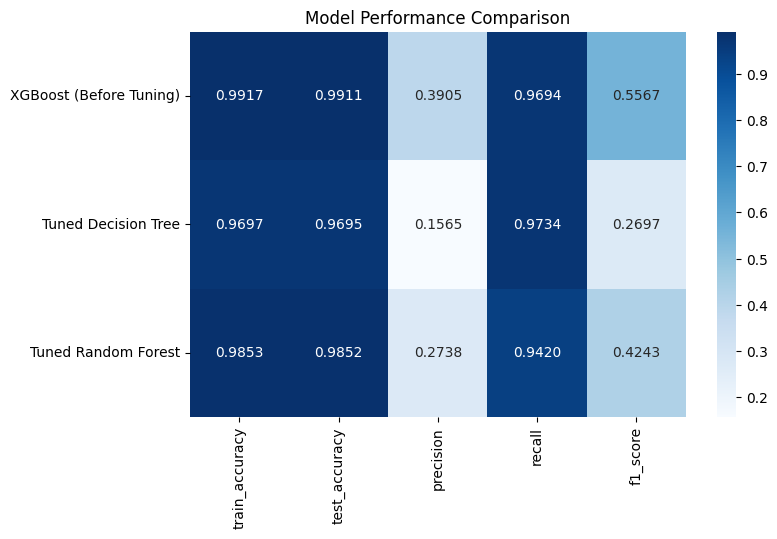

In [63]:
# Visualize Performance Using a Heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(metrics_df, annot=True, cmap="Blues", fmt=".4f")
plt.title("Model Performance Comparison")
plt.show()